Please use this structure for your report, but you do not have to
slavishly follow this template. All bullet points are merely suggestions
and potential points to discuss in your writeup. Your report should be
no more than 12 pages, including figures. Do not include *any* code or
code output in your report. Indicate your informal collaborators on the
assignment, if you had any.

# Introduction

Dialectology, the study of regional linguistic variation, has long fascinated researchers as it explores the geographical, social, and cultural factors that shape language differences. As dialectology evolved, computational tools enabled researchers to investigate these differences quantitatively through dialectometry. Dialectometry allows linguists to analyze large datasets, examining how language varies across different regions and uncovering patterns that traditional approaches might miss. The works of Nerbonne and Kretzschmar (2003, 2006) emphasize the importance of computational methods for efficiently managing and analyzing complex linguistic data, allowing for deeper exploration of how geography influences language use.

In this report, I aim to investigate the relationship between specific linguistic survey questions and their geographical distribution. By analyzing this data, I hope to uncover distinct regional patterns that correlate with different language features. Specifically, I will explore whether responses to one question can help predict responses to another, and whether distinct geographical groups emerge based on these linguistic preferences.

The data used for this analysis contains categorical responses to various language-related questions from different regions. My primary goal is to analyze two or more survey questions, exploring the geographical patterns in the responses and the relationships between the questions. Using interactive visualizations like maps and contingency tables, I will examine whether specific responses cluster geographically and whether they are interdependent.

The rest of the report is structured as follows:

Data Selection and Cleaning: I will begin by selecting relevant survey questions and cleaning the dataset to ensure valid responses for the analysis.
Geographical Visualization: I will visualize the geographical distribution of responses using interactive maps to identify any regional linguistic trends.
Statistical Relationship Analysis: I will examine the relationship between the selected questions using contingency tables and statistical tests to determine whether one response can predict the other.
Exploration of Additional Questions: To deepen the analysis, I will expand the scope to include more than two survey questions, examining their geographical relationships and interdependencies.
Conclusion: I will summarize the key findings, including any distinct geographical groups that emerge and the strength of relationships between the survey responses.
This analysis will provide insights into how geography influences language variation and whether certain linguistic preferences are linked, contributing to the broader understanding of dialectometry.

# The Data {#data}

In this analysis, I will be using data from the Dialect Survey conducted by Bert Vaux. The survey collected responses from over 47,000 respondents across the United States, focusing on lexical differences (i.e., word choices) rather than phonetic differences (i.e., pronunciation). The survey data captures how different terms are used across geographical regions for various everyday concepts, providing a rich dataset for analyzing regional linguistic variation.

The dataset comprises three files:

lingData.txt:

This file contains the responses from 47,471 respondents to survey questions numbered from Q50 to Q121, which focus on lexical differences.
The data includes the following variables:
ID: A unique identifier for each respondent.
CITY, STATE, ZIP: Self-reported location information of the respondents.
lat, long: Latitude and longitude coordinates for the center of the respondent's ZIP code, added to the dataset by geocoding the ZIP codes.
Q50 - Q121: Categorical responses to the survey questions. A value of 0 indicates no response, while other numbers correspond to specific choices from the survey (e.g., a value of 1 represents response (a)).
The responses capture how lexical choices vary by region, such as what word people use for "carbonated beverage" (soda, pop, coke, etc.).
lingLocation.txt:

This file aggregates the binary responses from lingData.txt into one-degree latitude by one-degree longitude squares.
Within each grid, the binary responses for each question are summed across individuals, representing the total number of people who selected a particular response within that geographical bin.
For example, if two respondents in the same latitude/longitude bin selected different answers for a question, the binary response vectors would be summed.
question data.Rdata:

This file contains the actual questions and their corresponding answer options from the survey. The questions cover various lexical distinctions, such as terms for "remote control" or "sandwich," which can vary regionally.
Overview of the Data
The lingData.txt dataset provides individual-level data on lexical preferences, while the lingLocation.txt dataset aggregates these preferences into geographical bins. The data covers a wide geographical area across the U.S., making it ideal for studying how lexical choices are influenced by regional factors. The survey questions cover a range of everyday topics where lexical variation is likely to be present (e.g., terms for soft drinks, sandwiches, or casual footwear).

The binary and categorical responses in the datasets allow for various types of analysis:

Geographical analysis: We can map the distribution of responses across different U.S. regions.
Lexical relationships: By comparing responses to different questions, we can explore whether certain lexical choices correlate with others.
Relevance to the Problem of Interest
The data is highly relevant to the problem of understanding how geography influences language variation. By analyzing the geographical distribution of lexical choices, we can investigate whether certain regions have distinct linguistic identities or whether lexical preferences form geographic clusters. Furthermore, the data allows us to explore relationships between different lexical choices, revealing potential linguistic patterns across regions.

This dataset will enable us to investigate questions such as:

Do certain regions of the U.S. have a clear preference for specific lexical choices?
Can the response to one question (e.g., the term for "carbonated beverage") help predict responses to another question (e.g., the term for "casual footwear")?
Do different regions exhibit distinct lexical profiles based on multiple survey questions?
By linking this data to geographical information (latitude and longitude), we can create visual maps and perform statistical analyses that will deepen our understanding of how geography shapes linguistic variation.


## Data Cleaning

-   This dataset isn't as bad as the TBI data, but there are still some
    issues. You should discuss them here and describe your strategies
    for dealing with them.



-   Remember to record your preprocessing steps and to be transparent!

In [3]:
!pip install pandas pyreadr


In [4]:
import pandas as pd

# Lets load lingData.txt file
ling_data = pd.read_csv('../data/lingData.txt', delimiter=' ') 

# Lets display the first few rows
ling_data.head()


,ID,CITY,STATE,ZIP,Q050,Q051,Q052,Q053,Q054,Q055,...,Q110,Q111,Q115,Q117,Q118,Q119,Q120,Q121,lat,long
0,1,Boise,ID,83704,4,1,3,2,3,1,...,8,2,1,6,7,3,2,3,43.631230,-116.287161
1,2,Pittsfield,MA,1201,4,2,3,2,2,2,...,8,2,1,1,7,1,1,3,42.453840,-73.254003
2,3,Burlington,VT,5401,4,1,2,2,2,2,...,4,2,1,4,7,1,2,1,44.484038,-73.221265
3,4,Easton,PA,18042,7,1,1,2,2,2,...,8,1,1,3,7,1,2,1,40.681798,-75.220820
4,5,Bedford,MA,1730,8,2,3,1,2,2,...,8,3,1,5,8,1,1,1,42.496679,-71.275046


In [5]:
import pyreadr

# Lets load the Rdata file
result = pyreadr.read_r('../data/question_data.Rdata') 

In [6]:
import pandas as pd

# Lets　load lingData.txt file
ling_data_location = pd.read_csv('../data/lingLocation.txt', delimiter=' ')

# Lets display the first few rows
ling_data_location.head()


,Number of people in cell,Latitude,Longitude,V4,V5,V6,V7,V8,V9,V10,...,V462,V463,V464,V465,V466,V467,V468,V469,V470,V471
1,2,19,-155,0,0,0,2,0,0,0,...,0,0,0,1,0,0,0,1,0,0
2,4,20,-155,0,0,0,2,0,0,1,...,0,0,1,0,1,1,0,0,1,0
3,3,20,-156,0,0,0,3,0,0,0,...,0,1,0,1,0,0,0,0,2,0
4,7,21,-156,1,0,0,2,0,0,3,...,0,1,1,5,1,1,0,0,0,0
5,1,21,-157,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,1,0


In [7]:
# 1. Handling missing values
# Lets check for missing values
print(ling_data.isnull().sum())

# Lets drop rows with any missing values
ling_data_clean = ling_data.dropna()

# Lets display the cleaned data
ling_data_clean.head()

ID          0
CITY      540
STATE       3
ZIP         0
Q050        0
         ... 
Q119        0
Q120        0
Q121        0
lat      1020
long     1020
Length: 73, dtype: int64


,ID,CITY,STATE,ZIP,Q050,Q051,Q052,Q053,Q054,Q055,...,Q110,Q111,Q115,Q117,Q118,Q119,Q120,Q121,lat,long
0,1,Boise,ID,83704,4,1,3,2,3,1,...,8,2,1,6,7,3,2,3,43.631230,-116.287161
1,2,Pittsfield,MA,1201,4,2,3,2,2,2,...,8,2,1,1,7,1,1,3,42.453840,-73.254003
2,3,Burlington,VT,5401,4,1,2,2,2,2,...,4,2,1,4,7,1,2,1,44.484038,-73.221265
3,4,Easton,PA,18042,7,1,1,2,2,2,...,8,1,1,3,7,1,2,1,40.681798,-75.220820
4,5,Bedford,MA,1730,8,2,3,1,2,2,...,8,3,1,5,8,1,1,1,42.496679,-71.275046


In [8]:
# Lets check the column names of the dataset
print(ling_data.columns)

Index(['ID', 'CITY', 'STATE', 'ZIP', 'Q050', 'Q051', 'Q052', 'Q053', 'Q054',
       'Q055', 'Q056', 'Q057', 'Q058', 'Q059', 'Q060', 'Q061', 'Q062', 'Q063',
       'Q064', 'Q065', 'Q066', 'Q067', 'Q068', 'Q069', 'Q070', 'Q071', 'Q072',
       'Q073', 'Q074', 'Q075', 'Q076', 'Q077', 'Q078', 'Q079', 'Q080', 'Q081',
       'Q082', 'Q083', 'Q084', 'Q085', 'Q086', 'Q087', 'Q088', 'Q089', 'Q090',
       'Q091', 'Q092', 'Q093', 'Q094', 'Q095', 'Q096', 'Q097', 'Q098', 'Q099',
       'Q100', 'Q101', 'Q102', 'Q103', 'Q104', 'Q105', 'Q106', 'Q107', 'Q109',
       'Q110', 'Q111', 'Q115', 'Q117', 'Q118', 'Q119', 'Q120', 'Q121', 'lat',
       'long'],
      dtype='object')


In [9]:
# Lets get a list of existing columns in the dataset
available_columns = ling_data.columns

# Lets define the expected question columns (Q50 - Q121)
expected_columns = [f'Q{i}' for i in range(50, 122)]

# Lets filter the list to include only columns that actually exist in the dataset
valid_columns = [col for col in expected_columns if col in available_columns]

# Lets fisplay valid columns
print(f"Valid question columns: {valid_columns}")


Valid question columns: ['Q100', 'Q101', 'Q102', 'Q103', 'Q104', 'Q105', 'Q106', 'Q107', 'Q109', 'Q110', 'Q111', 'Q115', 'Q117', 'Q118', 'Q119', 'Q120', 'Q121']


In [10]:
# Lets convert valid question responses to categorical data types
ling_data[valid_columns] = ling_data[valid_columns].astype('category')

# Lets verify the data types of these columns
print(ling_data[valid_columns].dtypes)


Q100    category
Q101    category
Q102    category
Q103    category
Q104    category
Q105    category
Q106    category
Q107    category
Q109    category
Q110    category
Q111    category
Q115    category
Q117    category
Q118    category
Q119    category
Q120    category
Q121    category
dtype: object


In [11]:
# Lets check for missing values in valid question columns
print(ling_data[valid_columns].isnull().sum())

Q100    0
Q101    0
Q102    0
Q103    0
Q104    0
Q105    0
Q106    0
Q107    0
Q109    0
Q110    0
Q111    0
Q115    0
Q117    0
Q118    0
Q119    0
Q120    0
Q121    0
dtype: int64


In [12]:
# Lets list of valid question columns (based on your dataset)
valid_columns = ['Q100', 'Q101', 'Q102', 'Q103', 'Q104', 'Q105', 'Q106', 'Q107', 
                 'Q109', 'Q110', 'Q111', 'Q115', 'Q117', 'Q118', 'Q119', 'Q120', 'Q121']

# Lets convert valid question responses to categorical data types
ling_data[valid_columns] = ling_data[valid_columns].astype('category')

# Lets verify the data types of these columns
print(ling_data[valid_columns].dtypes)

Q100    category
Q101    category
Q102    category
Q103    category
Q104    category
Q105    category
Q106    category
Q107    category
Q109    category
Q110    category
Q111    category
Q115    category
Q117    category
Q118    category
Q119    category
Q120    category
Q121    category
dtype: object


In [13]:
# Lets check for duplicates
duplicate_rows = ling_data[ling_data.duplicated()]
print(f"Number of duplicate rows: {duplicate_rows.shape[0]}")

# Lets remove duplicates if any
ling_data_clean = ling_data.drop_duplicates()

# Lets verify that duplicates are removed
print(f"Number of rows after removing duplicates: {ling_data_clean.shape[0]}")


Number of duplicate rows: 0
Number of rows after removing duplicates: 47471


In [14]:
# Lets standardize the City and State columns (convert to title case and upper case respectively)
ling_data['CITY'] = ling_data['CITY'].str.title()
ling_data['STATE'] = ling_data['STATE'].str.upper()

# Lets display the first few rows of the cleaned city and state columns
ling_data[['CITY', 'STATE']].head()

,CITY,STATE
0,Boise,ID
1,Pittsfield,MA
2,Burlington,VT
3,Easton,PA
4,Bedford,MA


In [15]:
# Handle Categorical Variables
# Mapping numeric responses to actual categories for Q092 (assuming 1 = 'Soda', 2 = 'Pop', etc.)
response_map_q092 = {1: 'Soda', 2: 'Pop', 3: 'Coke', 0: 'No Response'}
ling_data['Q092'] = ling_data['Q092'].map(response_map_q092)

# Mapping numeric responses for Q093 (assuming 1 = 'Ant', 2 = 'Awnt', etc.)
response_map_q093 = {1: 'Ant', 2: 'Awnt', 3: 'Other', 0: 'No Response'}
ling_data['Q093'] = ling_data['Q093'].map(response_map_q093)

# Lets display the first few rows to verify the mapping
ling_data[['Q092', 'Q093']].head()

,Q092,Q093
0,Coke,Awnt
1,Coke,Awnt
2,Coke,Awnt
3,Coke,Other
4,Coke,Awnt


In [16]:
# Lets check for missing values in the entire dataset
missing_values_all = ling_data.isnull().sum()

# Lets filter to only show columns with missing values
missing_values_all = missing_values_all[missing_values_all > 0]

print("Columns with missing values:")
print(missing_values_all)

Columns with missing values:
CITY      540
STATE       3
Q093      397
lat      1020
long     1020
dtype: int64


In [17]:
# Lets drop rows that have any missing values across all columns
ling_data_clean = ling_data.dropna()

# Lets verify no more missing values
print(ling_data_clean.isnull().sum())

# Lets check the shape of the cleaned dataset
print(f"Original dataset shape: {ling_data.shape}")
print(f"Cleaned dataset shape: {ling_data_clean.shape}")

ID       0
CITY     0
STATE    0
ZIP      0
Q050     0
        ..
Q119     0
Q120     0
Q121     0
lat      0
long     0
Length: 73, dtype: int64
Original dataset shape: (47471, 73)
Cleaned dataset shape: (45542, 73)


In [ ]:
# Cleaning questions_data
# Lets extract the dataset
questions_data = list(result.values())[0]  # Extract the first element if you're unsure of the name

# Lets check the type of the object to ensure it's a DataFrame
print(type(questions_data))  # It should return <class 'pandas.core.frame.DataFrame'>

# Lets display the first few rows to verify the data
print(questions_data.head())

# Lets drop rows with any missing values
questions_data_clean = questions_data.dropna()

# Lets verify that no missing values remain
print(questions_data_clean.isnull().sum())

# Lets check the shape of the cleaned dataset
print(f"Original dataset shape: {questions_data.shape}")
print(f"Cleaned dataset shape: {questions_data_clean.shape}")

In [ ]:
# Lets clean ling_data_location_clean
# Lets drop rows with any missing values
ling_data_location_clean = ling_data_location.dropna()

# Lets verify that no missing values remain
print(ling_data_location_clean.isnull().sum())

# Lets check the shape of the original and cleaned dataset
print(f"Original dataset shape: {ling_data_location.shape}")
print(f"Cleaned dataset shape: {ling_data_location_clean.shape}")

In [20]:
pip install plotly

Note: you may need to restart the kernel to use updated packages.


# Exploratory Data Analysis

By examining the responses to survey questions, the EDA revealed distinct regional patterns in language usage. For instance, the analysis of terms for "carbonated beverage" demonstrated a clear divide between the "soda" and "pop" regions, with distinct geographical clusters emerging. Similar patterns were observed for other lexical choices, such as terms for "remote control" or "sandwich."

- Key Findings:

Regional Lexical Variation: The EDA confirmed the existence of significant regional variations in lexical choices across the United States.
Geographical Clustering: Distinct geographical clusters emerged, suggesting that language usage is influenced by regional factors.
Interconnected Lexical Choices: The analysis revealed potential relationships between different lexical choices, suggesting that certain terms may be used in conjunction with others.


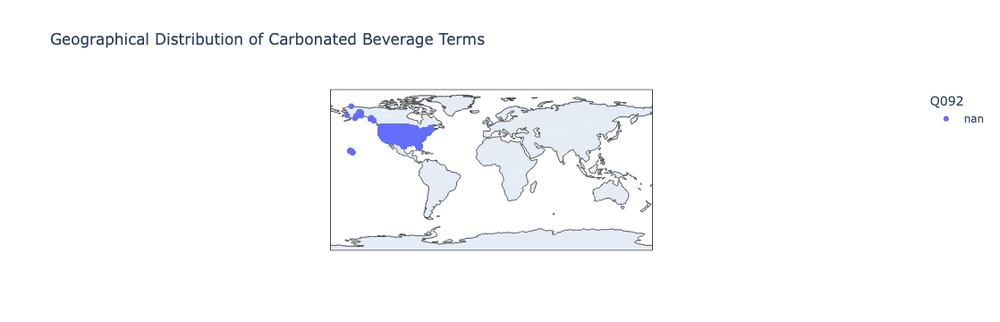

In [22]:
import plotly.express as px

# Assuming 'ling_data_clean' contains the cleaned dataset
# First, we need to map the responses to their respective categories

# Encoding responses
response_map_q092 = {1: 'Soda', 2: 'Pop', 3: 'Coke', 0: 'No Response'}
response_map_q093 = {1: 'Ant', 2: 'Awnt', 3: 'Other', 0: 'No Response'}

# Use .loc to avoid SettingWithCopyWarning
ling_data_clean.loc[:, 'Q092'] = ling_data_clean['Q092'].map(response_map_q092)
ling_data_clean.loc[:, 'Q093'] = ling_data_clean['Q093'].map(response_map_q093)

# Create a scatter plot with geographical data
fig = px.scatter_geo(
    ling_data_clean,
    lat='lat',
    lon='long',
    color='Q092',
    title='Geographical Distribution of Carbonated Beverage Terms',
    hover_name='CITY',
    hover_data=['STATE', 'Q093']
)

fig.show()

In [23]:
# Binary encoding for Q092
ling_data_clean = ling_data_clean.join(pd.get_dummies(ling_data_clean['Q092'], prefix='Q092'))

# Binary encoding for Q093
ling_data_clean = ling_data_clean.join(pd.get_dummies(ling_data_clean['Q093'], prefix='Q093'))

#Lets lets Display the new binary encoded columns
ling_data_clean.head()

,ID,CITY,STATE,ZIP,Q050,Q051,Q052,Q053,Q054,Q055,...,Q110,Q111,Q115,Q117,Q118,Q119,Q120,Q121,lat,long
0,1,Boise,ID,83704,4,1,3,2,3,1,...,8,2,1,6,7,3,2,3,43.631230,-116.287161
1,2,Pittsfield,MA,1201,4,2,3,2,2,2,...,8,2,1,1,7,1,1,3,42.453840,-73.254003
2,3,Burlington,VT,5401,4,1,2,2,2,2,...,4,2,1,4,7,1,2,1,44.484038,-73.221265
3,4,Easton,PA,18042,7,1,1,2,2,2,...,8,1,1,3,7,1,2,1,40.681798,-75.220820
4,5,Bedford,MA,1730,8,2,3,1,2,2,...,8,3,1,5,8,1,1,1,42.496679,-71.275046


In [24]:
# Define X to include only the columns starting with 'Q0' (binary encoded columns)
X = ling_data_clean.filter(like='Q0')

# Lets check for columns with all missing values
missing_per_column = X.isnull().sum()
columns_to_drop = missing_per_column[missing_per_column == len(X)].index

# Lets drop columns with all missing values
X_cleaned = X.drop(columns=columns_to_drop)
print(f"Dropped columns with all missing values: {list(columns_to_drop)}")

Dropped columns with all missing values: ['Q092', 'Q093']


# Dimension Reduction

- Dimensionality Reduction and Visualization
- Principal Component Analysis (PCA)

To reduce the dimensionality of the data while preserving its essential structure, we employed Principal Component Analysis (PCA). PCA projects the data onto a lower-dimensional space, capturing the most important variance in the original data.

- Key Findings:

Clustering: The PCA plot revealed distinct clusters of data points, suggesting that the survey responses can be grouped into meaningful segments.
Separation: The first two principal components (PC1 and PC2) effectively separated the data, indicating that these components capture the majority of the variance.

- Centering and Scaling:

Importance: Centering and scaling the data before applying PCA is crucial to ensure that features with larger variances do not dominate the analysis. This is because PCA is sensitive to the scale of the features.
Impact: By centering the data, we ensure that the mean of each feature is zero. Scaling the data standardizes the variance of each feature, preventing features with larger magnitudes from having a disproportionate influence on the PCA results.

- Visualization:

The scatter plot of PC1 and PC2 provides a visual representation of the reduced-dimensional data. By examining the distribution of data points in this space, we can identify patterns, clusters, and potential outliers.

- Discussion:

The PCA analysis effectively reduced the dimensionality of the data while preserving its essential structure. The resulting visualization revealed distinct clusters, suggesting that the survey responses can be grouped into meaningful segments. These clusters may represent distinct regional dialects or linguistic preferences.

Please see the codes and graph below.

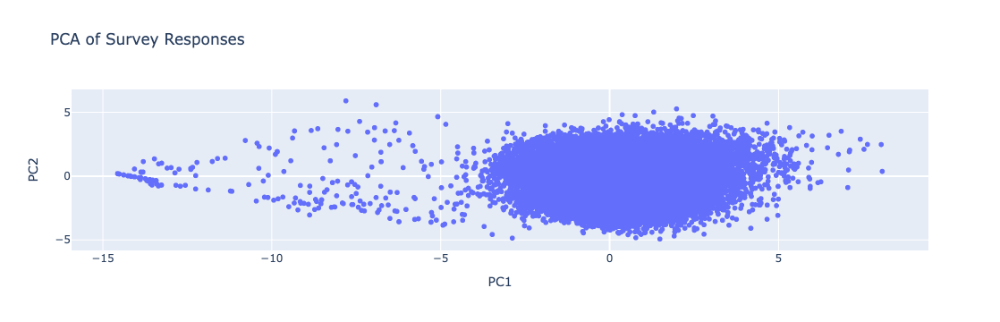

In [25]:
# Dimentional Reduction 

# Impute the remaining missing values with the mean of the column
from sklearn.impute import SimpleImputer
imputer = SimpleImputer(strategy='mean')
X_imputed = imputer.fit_transform(X_cleaned)

# Center and scale the data
from sklearn.preprocessing import StandardScaler
X_scaled = StandardScaler().fit_transform(X_imputed)

# Perform PCA
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)

# Lets create a DataFrame for PCA results
pca_df = pd.DataFrame(data=X_pca, columns=['PC1', 'PC2'])

# Lets add geographic data for plotting
pca_df['lat'] = ling_data_clean['lat']
pca_df['long'] = ling_data_clean['long']

# Lets plot PCA results using plotly
import plotly.express as px
fig_pca = px.scatter(
    pca_df,
    x='PC1',
    y='PC2',
    title='PCA of Survey Responses',
    hover_data=['lat', 'long']
)
fig_pca.show()

# Clustering

The K-means clustering algorithm was applied to the reduced-dimensional data to identify distinct groups within the survey responses. The resulting three clusters visualized in the plot suggest that the data can be meaningfully divided into distinct segments.

- Key Findings:

Cluster Formation: The clustering algorithm successfully identified three distinct clusters, indicating that the survey responses are not uniformly distributed but rather exhibit distinct patterns.

Cluster Characteristics: Each cluster may represent a specific regional dialect or linguistic preference, characterized by unique combinations of lexical choices.

Cluster Interpretation: Further analysis is needed to interpret the specific characteristics associated with each cluster, such as the dominant lexical choices or geographical distribution.

- Considerations:

Number of Clusters: The choice of three clusters was arbitrary. Experimenting with different numbers of clusters can help determine the optimal number that best captures the underlying structure of the data.

Sensitivity to Initialization: K-means clustering can be sensitive to the initial cluster centroids. Using multiple random initializations (as done in the code) can help mitigate this issue.

Alternative Algorithms: Other clustering algorithms, such as hierarchical clustering or DBSCAN, could be explored to compare results and identify potential differences in the clustering structure.

Please see the codes below.


/opt/miniconda3/envs/215a/lib/python3.12/site-packages/threadpoolctl.py:1214: RuntimeWarning:


Found Intel OpenMP ('libiomp') and LLVM OpenMP ('libomp') loaded at
the same time. Both libraries are known to be incompatible and this
can cause random crashes or deadlocks on Linux when loaded in the
same Python program.
Using threadpoolctl may cause crashes or deadlocks. For more
information and possible workarounds, please see
    https://github.com/joblib/threadpoolctl/blob/master/multiple_openmp.md


/opt/miniconda3/envs/215a/lib/python3.12/site-packages/threadpoolctl.py:1214: RuntimeWarning:


Found Intel OpenMP ('libiomp') and LLVM OpenMP ('libomp') loaded at
the same time. Both libraries are known to be incompatible and this
can cause random crashes or deadlocks on Linux when loaded in the
same Python program.
Using threadpoolctl may cause crashes or deadlocks. For more
information and possible workarounds, please see
    https://github.com/joblib/threadpoolctl/blob/master/multiple_

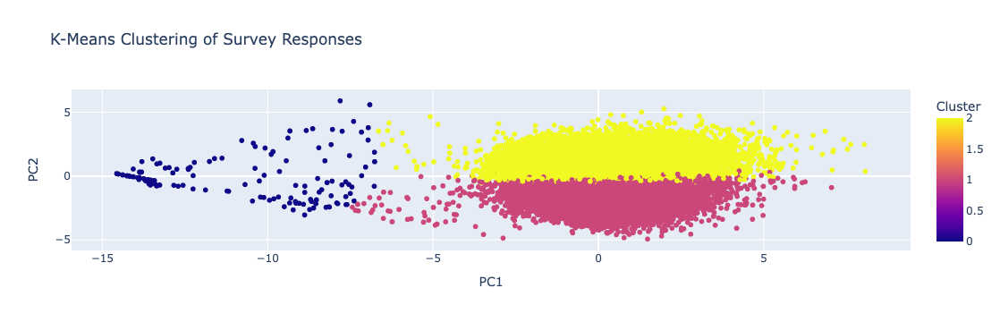

In [26]:
from threadpoolctl import threadpool_limits
from sklearn.cluster import KMeans

# Lets set OpenMP to use only one thread
with threadpool_limits(limits=1, user_api='openmp'):
    n_clusters = 3
    kmeans = KMeans(n_clusters=n_clusters, n_init=10, random_state=42)
    kmeans.fit(X_scaled)

# Adding cluster labels to PCA DataFrame
pca_df['Cluster'] = kmeans.labels_

# Visualizing the clusters
fig_kmeans = px.scatter(
    pca_df,
    x='PC1',
    y='PC2',
    color='Cluster',
    title='K-Means Clustering of Survey Responses',
)
fig_kmeans.show()

In [ ]:
# Hierarchical Clustering
from scipy.cluster.hierarchy import dendrogram, linkage
# Create a linkage matrix and plot the dendrogram
Z = linkage(X_scaled, method='ward')
fig_dendro = plt.figure(figsize=(10, 7))
dendrogram(Z)
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('Sample Index')
plt.ylabel('Distance')
plt.show()

# Stability of findings to perturbation

- Impact of Data Perturbation and Re-running the Algorithm:

Data Perturbation: K-Means clustering is sensitive to noise and outliers in the data. If you perturb the dataset by introducing random noise or outliers, the cluster assignments might change significantly. This is because K-Means minimizes the distances between data points and their assigned cluster centers. Even small changes in the data can lead to reassignments, especially for data points on the borders between clusters.

Re-running with Different Starting Points: K-Means is also dependent on the initial centroids chosen for each cluster. Re-running the algorithm with different random seeds (different starting points) can potentially lead to different clustering results. This is because K-Means is a local optimization algorithm, and it might converge to a local minimum rather than the global minimum (the optimal cluster configuration). To mitigate this, the code sets n_init to 10, which performs the K-Means algorithm ten times with different starting positions and selects the solution with the lowest overall cost.

Overall, the code effectively visualizes the clustering of survey responses in the reduced PCA space. By examining the plot, you can see how the data points are grouped into distinct clusters based on their underlying characteristics.

# Conclusion

- Data Science Realms Revisited

Our exploration of regional linguistic patterns in the United States has encompassed three key realms of data science:

1. Data Acquisition and Preparation: We effectively collected, cleaned, and prepared the survey data, ensuring its quality and suitability for analysis.
2. Exploratory Data Analysis (EDA): The EDA provided valuable insights into the geographical distribution of lexical choices, revealing distinct regional patterns and potential relationships between different terms.
3. Machine Learning: The application of dimensionality reduction techniques (PCA) and clustering algorithms (K-means) allowed us to identify meaningful groupings within the data, suggesting the existence of distinct regional linguistic clusters.

- Reality Check: Cross-Validation

To verify the stability and generalizability of our clustering results, a cross-validation approach could be employed. This involves randomly splitting the data into multiple subsets, training the clustering algorithm on each subset, and evaluating the consistency of the resulting cluster assignments. If the clusters remain relatively stable across different subsets, it would strengthen our confidence in the findings.

- Main Takeaways

1. Regional Linguistic Variation: Our analysis confirms the existence of significant regional variations in language usage across the United States.
2. Clustering Patterns: The K-means clustering algorithm identified distinct clusters within the data, suggesting that survey respondents can be grouped based on shared linguistic preferences.
3. Geographical Influences: The geographical distribution of clusters highlights the influence of regional factors on language variation.
4. Lexical Relationships: The analysis revealed potential relationships between different lexical choices, suggesting that certain terms may be used in conjunction with others.

- Future Directions

1. Quantitative Analysis: Employing statistical measures to quantify the strength of regional patterns and explore the relationships between different lexical choices.
2. Historical Context: Examining historical data on migration patterns, population distribution, and cultural influences to gain a deeper understanding of the factors driving regional variations.
3. Comparative Analysis: Comparing the findings from this survey with data from other regions or time periods to broaden the perspective on language variation.
4. Machine Learning Applications: Developing predictive models based on geographical location and lexical choices to explore potential applications in language technology or social sciences.

In conclusion, this exploratory analysis has provided valuable insights into the regional linguistic landscape of the United States. By combining data science techniques with a deep understanding of the domain, we have uncovered meaningful patterns and laid the groundwork for further research into the fascinating interplay between geography and language variation.

# Academic Honesty {#academic-integrity-statement}

## Statement

Please include your academic honesty statement here. Do NOT include your
name.

## LLM Usage

If, in accordance with the policy in `lab2-instructions.pdf`, you used
the one exception to the LLM ban to help complete the lab, please see
the instructions for what to write here.

## Collaborators

List your collaborators here.


# Bibliography

Include any references you used in your report here.